In [1]:
from matplotlib import pyplot as plt
import numpy as np
import torch

from competition.dataloaders import AVAILABLE_BENCHMARKS, BenchmarkDataloader
from competition.models.bnn.binary_scalex2_baseline_v1_with_spatial import BinaryScalex2BaselineV1WithSpatial

In [2]:
model = BinaryScalex2BaselineV1WithSpatial(n_blocks_skip=2, n_residual_blocks=12)
model = torch.load('models/baselinev1_with_spatial.ckpt')

In [3]:
loader = BenchmarkDataloader('set14', scale=2)

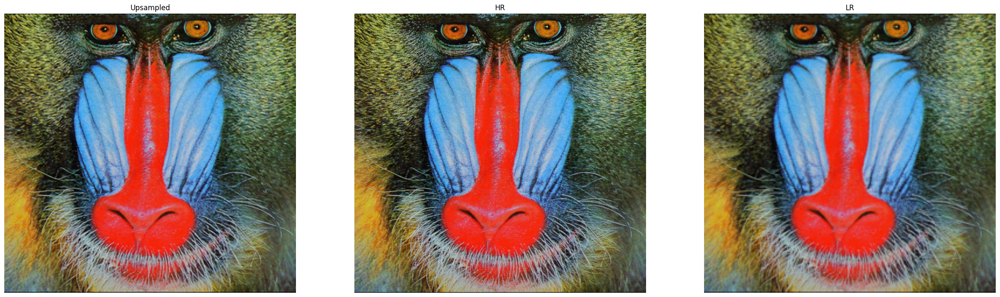

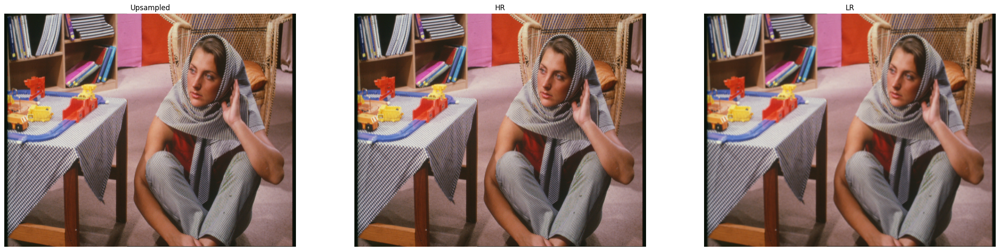

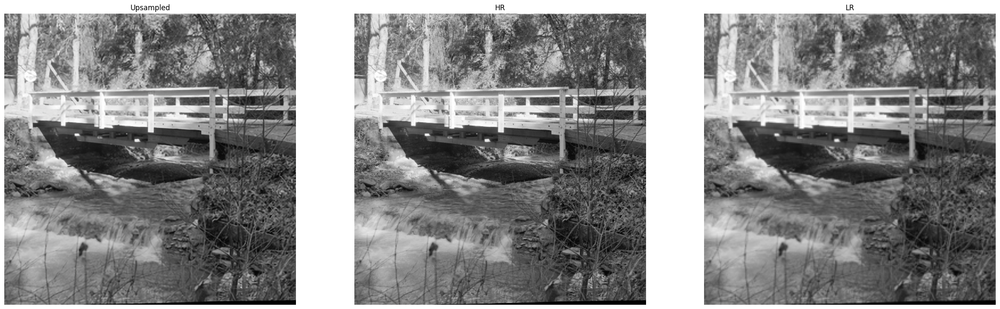

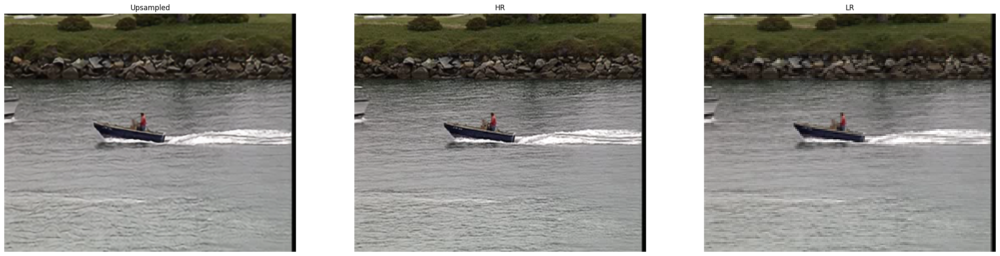

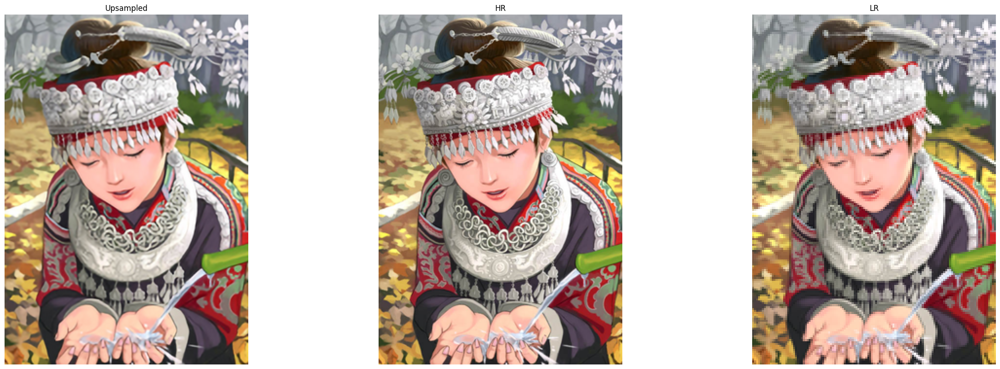

...

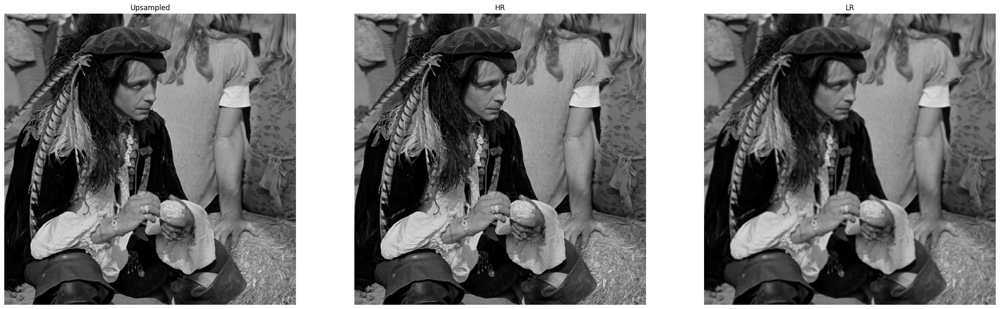

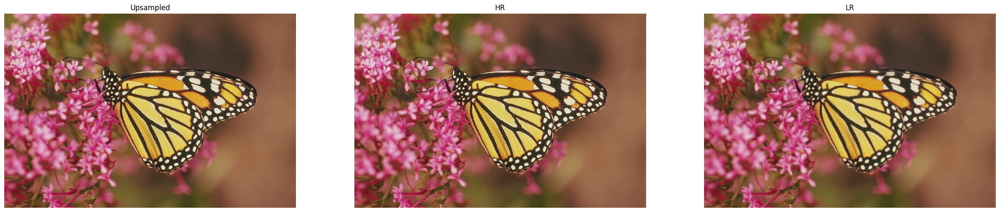

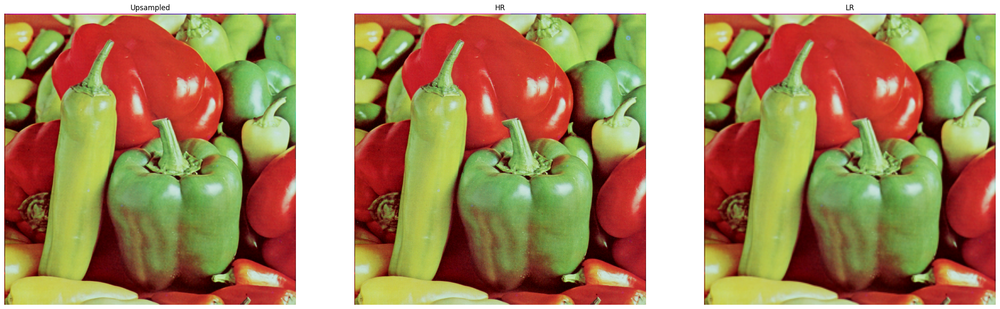

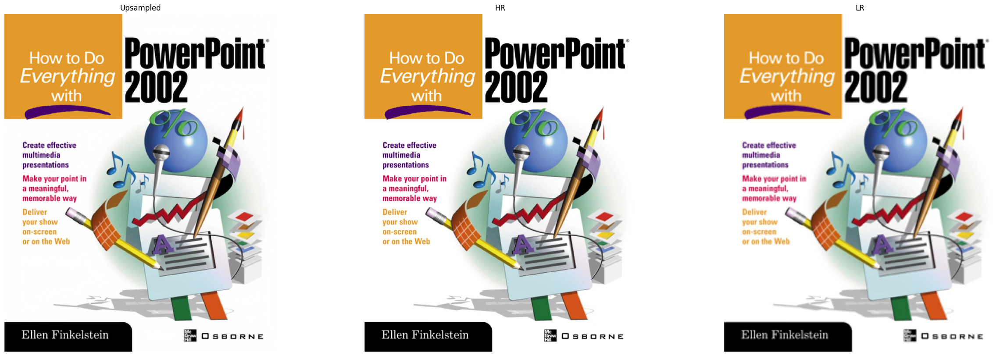

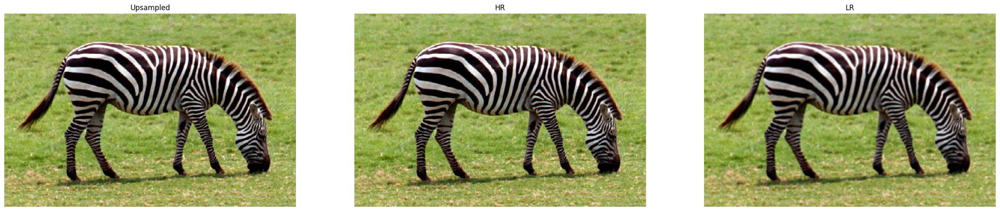

In [5]:
IMAGE_NAMES = 'baboon barbara bridge coastguard comic face flowers foreman lenna man monarch pepper ppt3 zebra'.split()
for (lr, hr), name in zip(loader.loader, IMAGE_NAMES):
    upsampled = model(lr.cuda()).detach().cpu()
    upsampled = torch.clip(upsampled, 0, 255)
    fig = plt.figure(figsize=(30, 10))
    ax = plt.subplot(131)
    ax.set_title('Upsampled')
    ax.axis('off')
    plt.imshow(np.transpose(upsampled[0].numpy() / 255, [1, 2, 0]))
    ax = plt.subplot(132)
    ax.set_title('HR')
    ax.axis('off')
    plt.imshow(np.transpose(hr[0].numpy() / 255, [1, 2, 0]))
    ax = plt.subplot(133)
    ax.set_title('LR')
    ax.axis('off')
    plt.imshow(np.transpose(lr[0].numpy() / 255, [1, 2, 0]))
    plt.show()